# Importing Required Libraries

In [5]:
# Importing necessary libraries
import os
import cv2
import numpy as np
import pandas as pd
import shutil
import glob
from glob import glob
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import xml.etree.ElementTree as ET
from PIL import Image
import pytesseract
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Input, Dense, Conv2D, Flatten, MaxPool2D, Dropout, Activation, GlobalAveragePooling2D, BatchNormalization, GlobalMaxPooling2D
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, CSVLogger, ModelCheckpoint, TensorBoard
from tensorflow.keras.models import Model
from PIL import Image
from tensorflow.keras import backend
import warnings
warnings.filterwarnings("ignore")
pd.set_option("display.max_rows",None)

# setting style for plots
sns.set(style="whitegrid")

# Loading Raw Data

In [2]:
from datasets import load_dataset      # importing datasets library
dataset = load_dataset("keremberke/license-plate-object-detection",'full')   # loading car license plate dataset

Generating train split:   0%|          | 0/6176 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/1765 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/882 [00:00<?, ? examples/s]

##### Since we have to upload dataset from datasets, thus need to create required directories

In [3]:
# creating required libraries
os.mkdir('/kaggle/working/data')
os.mkdir('/kaggle/working/data/train')
os.mkdir('/kaggle/working/data/test')
os.mkdir('/kaggle/working/data/val')

In [4]:
# creating a config for further application of models and data creation
class Config:
    size = 200
    img_size = (size, size, 3)
    batch_size = 32
    test_size = 0.15
    random_state = 42
config = Config()

In [6]:
# Checking the structure of the dataset
print(dataset)

DatasetDict({
    train: Dataset({
        features: ['image_id', 'image', 'width', 'height', 'objects'],
        num_rows: 6176
    })
    validation: Dataset({
        features: ['image_id', 'image', 'width', 'height', 'objects'],
        num_rows: 1765
    })
    test: Dataset({
        features: ['image_id', 'image', 'width', 'height', 'objects'],
        num_rows: 882
    })
})


# Data Preprocessing

The dataset consists of following features : image_id, image, width, height and object. Here object features contains area, and bounding boxes details in COCO format so need to relocate the annotations and transform the data

In [7]:
# function to relocate the annotations
def relocate_annotation(example, size):
    y_ = example['height']           # Extracting original width and height from the example
    x_ = example['width']

    x_scale = size / x_                   # scaling factors
    y_scale = size / y_

    a, b, c, d = example['objects']['bbox'][0]         # Extracting bounding box coordinates 
    
    (origLeft, origTop, origRight, origBottom) = (a, b, a+c, b+d)

    x = int(np.round(origLeft * x_scale))
    y = int(np.round(origTop * y_scale))
    xmax = int(np.round(origRight * x_scale))      # Apply scaling to bounding box coordinates and round to nearest integer
    ymax = int(np.round(origBottom * y_scale))
    return (x, y, xmax, ymax)

In [8]:
# function for transforming the dataset
def transform(examples):                                           
    examples["pixel_values"] = [
        cv2.resize(np.array(image), (config.size, config.size)) for image in examples["image"]               # Resizing each image to the target size specified in the config
    ]
    examples["labels"] = [                           
        [values['bbox'][0][0], values['bbox'][0][1], values['bbox'][0][0] + values['bbox'][0][2], values['bbox'][0][1] + values['bbox'][0][3]] for values in examples["objects"]
    ]                                                  # Updating bounding box coordinates for each object

    return examples
dataset.set_transform(transform)        # Applying the transform function to the dataset

In [9]:
def relocate_annotation(dataset, size):
    labels = []                       # Initializing an empty list to store updated bounding box coordinates
    for i in range(len(dataset)):
        height = dataset[i]['height']
        width = dataset[i]['width']

        x_scale = size / width                     # Computing scaling factors for x and y dimensions based on the target size
        y_scale = size / height
                
        (origLeft, origTop, origRight, origBottom) = dataset[i]['labels']             # Extracting the original bounding box coordinates (left, top, right, bottom)

        x = int(np.round(origLeft * x_scale))
        y = int(np.round(origTop * y_scale))

        xmax = int(np.round(origRight * x_scale))
        ymax = int(np.round(origBottom * y_scale))
        labels.append([x, y, xmax, ymax])
    return np.array(labels)

In [10]:
# Converting pixel values for training, validation, and test datasets to NumPy arrays
X_train = np.array(dataset['train'][:]['pixel_values']) 
X_val = np.array(dataset['validation'][:]['pixel_values']) 
X_test = np.array(dataset['test'][:]['pixel_values']) 

# Relocating and resize bounding box annotations for training, validation, and test datasets
y_train = relocate_annotation(dataset['train'], config.size) 
y_val = relocate_annotation(dataset['validation'], config.size) 
y_test = relocate_annotation(dataset['test'], config.size) 


# Exploratory Data Analysis

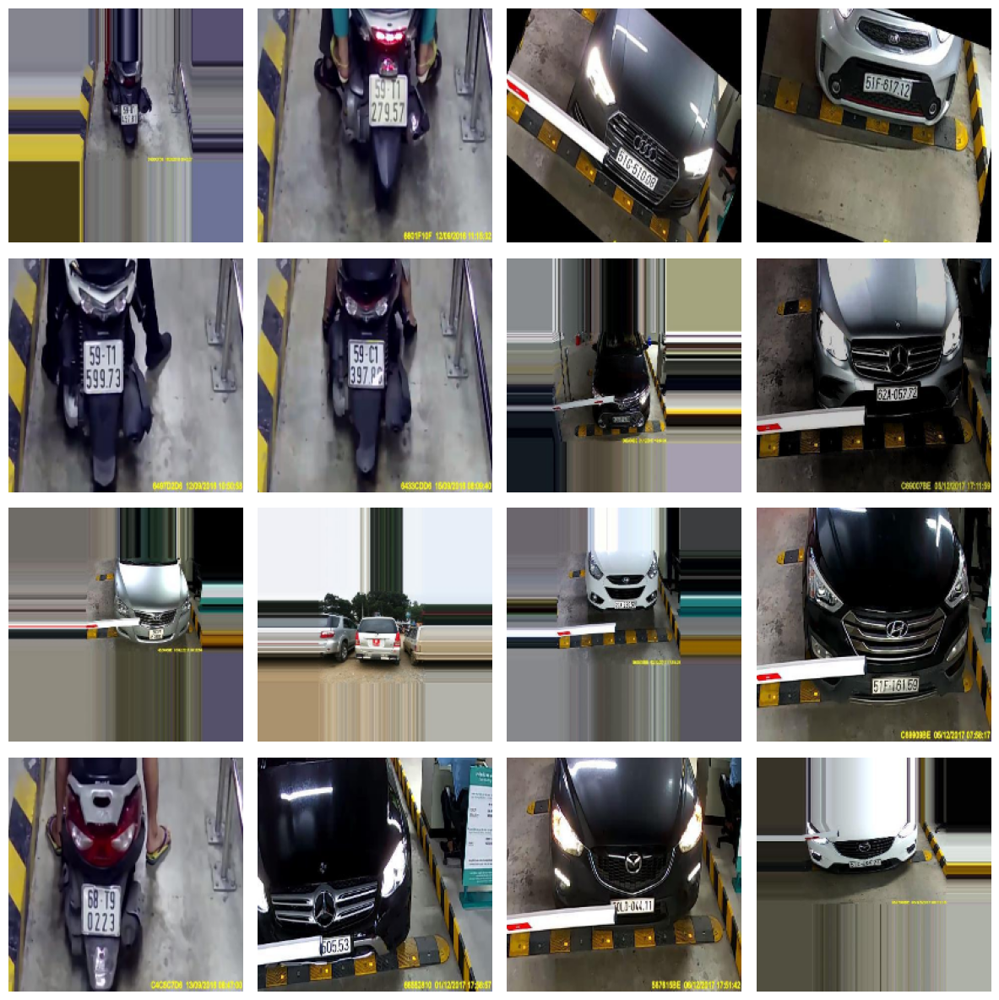

In [16]:
def show_images_grid(images, num_images=16, grid_size=(4, 4)):
    # Checking if we have enough images
    assert num_images <= len(images), "Not enough images in the dataset"

    # Randomly selecting indices
    indices = np.random.choice(len(images), num_images, replace=False)
    
    
    fig, axes = plt.subplots(grid_size[0], grid_size[1], figsize=(12, 12))
    
    
    axes = axes.flatten()
    
    for i, idx in enumerate(indices):
        image = images[idx]
        # Converting image to PIL format
        image = Image.fromarray(image)
        
        # Showing image on subplot
        axes[i].imshow(image)
        axes[i].axis('off')  # Hide axis
    
    
    for j in range(num_images, len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()

# Showing 16 random images from the training set
show_images_grid(X_train)

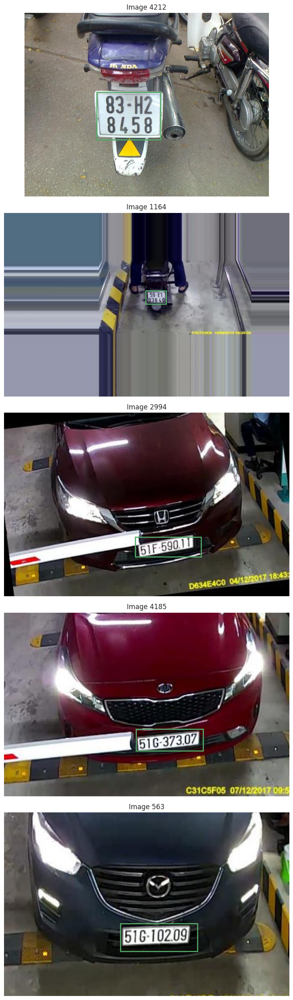

In [17]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np
from datasets import DatasetDict

def show_random_plates(dataset: DatasetDict, num_images: int = 5, from_where: str = 'test') -> None:
    _, axes = plt.subplots(num_images, 1, figsize=(10, 5 * num_images))
    
    # Generating random indices
    random_indices = np.random.choice(len(dataset[from_where]), num_images, replace=False).tolist()
    
    for i, index in enumerate(random_indices):
        index = int(index)
        random_sample = dataset[from_where][index]
        img = random_sample['image']
        plates = random_sample['objects']['bbox']
        
        ax = axes[i] if num_images > 1 else axes
        
        ax.imshow(img)
        
        for plate_index in range(len(plates)):
            x, y, width, height = plates[plate_index]
            
            rect = patches.Rectangle((x, y), width, height, fill=False, linewidth=2, edgecolor='g', facecolor='none')
            ax.add_patch(rect)
        
        ax.axis('off')
        ax.set_title(f'Image {index}')
    
    plt.tight_layout()
    plt.show()

# Showing 5 random images with bounding boxes from the train set
show_random_plates(dataset, num_images=5, from_where='train')


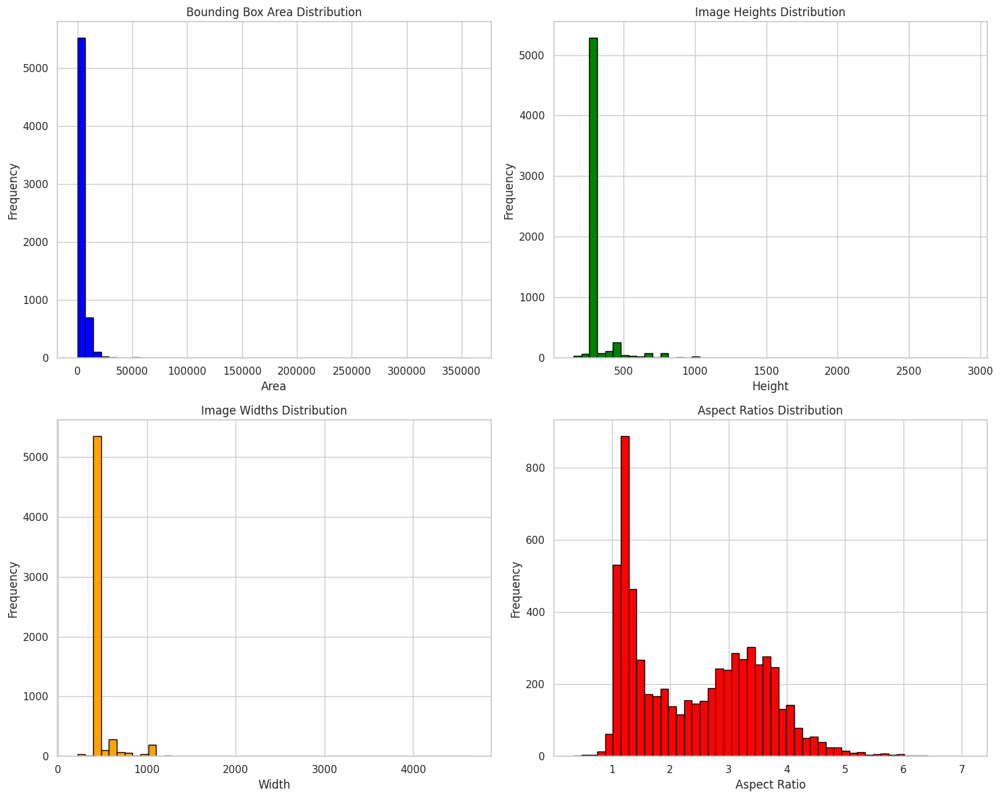

In [18]:
import matplotlib.pyplot as plt
import numpy as np
from datasets import DatasetDict

def plot_histograms(dataset: DatasetDict, from_where: str = 'test') -> None:
    # Extracting image dimensions and bounding boxes
    image_heights = []
    image_widths = []
    bbox_areas = []
    aspect_ratios = []

    for sample in dataset[from_where]:
        height = sample['height']
        width = sample['width']
        image_heights.append(height)
        image_widths.append(width)
        
        # Bounding boxes
        for bbox in sample['objects']['bbox']:
            x, y, w, h = bbox
            bbox_areas.append(w * h)
            aspect_ratios.append(w / h)
    
    # Plotting histograms
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))

    # Bounding Box Area Distribution
    axes[0, 0].hist(bbox_areas, bins=50, color='blue', edgecolor='black')
    axes[0, 0].set_title('Bounding Box Area Distribution')
    axes[0, 0].set_xlabel('Area')
    axes[0, 0].set_ylabel('Frequency')

    # Image Heights Distribution
    axes[0, 1].hist(image_heights, bins=50, color='green', edgecolor='black')
    axes[0, 1].set_title('Image Heights Distribution')
    axes[0, 1].set_xlabel('Height')
    axes[0, 1].set_ylabel('Frequency')

    # Image Widths Distribution
    axes[1, 0].hist(image_widths, bins=50, color='orange', edgecolor='black')
    axes[1, 0].set_title('Image Widths Distribution')
    axes[1, 0].set_xlabel('Width')
    axes[1, 0].set_ylabel('Frequency')

    # Aspect Ratios Distribution
    axes[1, 1].hist(aspect_ratios, bins=50, color='red', edgecolor='black')
    axes[1, 1].set_title('Aspect Ratios Distribution')
    axes[1, 1].set_xlabel('Aspect Ratio')
    axes[1, 1].set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Plot histograms for the 'train' set
plot_histograms(dataset, from_where='train')

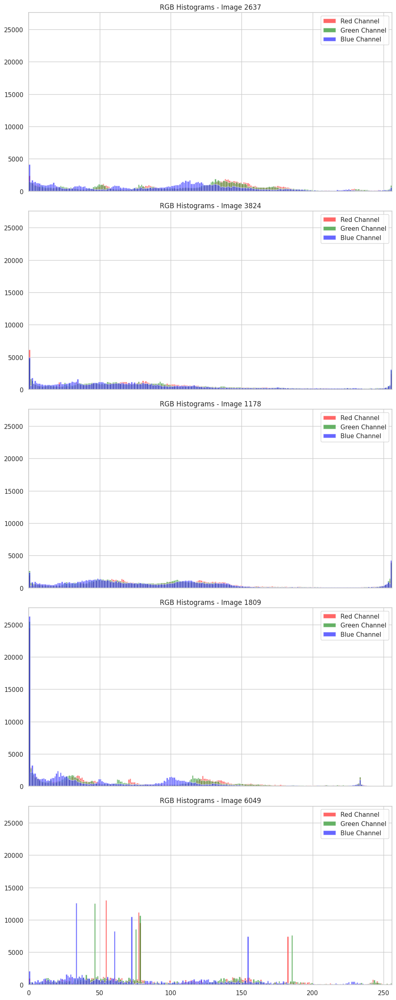

In [19]:
import matplotlib.pyplot as plt
import numpy as np
from datasets import DatasetDict

def plot_rgb_histograms(dataset: DatasetDict, num_images: int = 5, from_where: str = 'test') -> None:
    random_indices = np.random.choice(len(dataset[from_where]), num_images, replace=False)
    
    fig, axes = plt.subplots(num_images, 1, figsize=(10, 5 * num_images), sharex=True, sharey=True)

    for i, index in enumerate(random_indices):
        index = int(index)
        
        sample = dataset[from_where][index]
        img = np.array(sample['image'])
        
        # Splitting the image into RGB channels
        r_channel = img[:, :, 0].ravel()
        g_channel = img[:, :, 1].ravel()
        b_channel = img[:, :, 2].ravel()

        # Plot histograms for each channel
        axes[i].hist(r_channel, bins=256, color='red', alpha=0.6, range=(0, 256), label='Red Channel')
        axes[i].hist(g_channel, bins=256, color='green', alpha=0.6, range=(0, 256), label='Green Channel')
        axes[i].hist(b_channel, bins=256, color='blue', alpha=0.6, range=(0, 256), label='Blue Channel')

        axes[i].set_title(f'RGB Histograms - Image {index}')
        axes[i].set_xlim(0, 256)
        axes[i].legend()

    plt.tight_layout()
    plt.show()

# Plot RGB histograms for 5 random images from the 'train' set
plot_rgb_histograms(dataset, num_images=5, from_where='train')

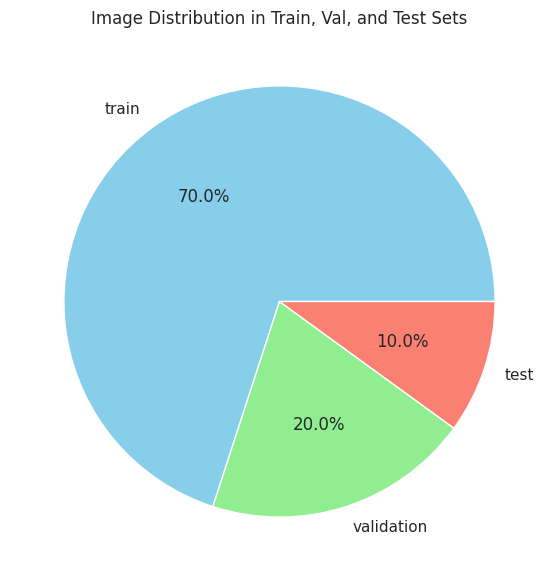

In [20]:
import os
import matplotlib.pyplot as plt
from datasets import DatasetDict

def plot_image_counts_pie_chart(dataset: DatasetDict) -> None:
    # Count images in each split
    image_counts = {split: len(dataset[split]) for split in dataset.keys()}
    
    # Data for the pie chart
    labels = list(image_counts.keys())
    sizes = list(image_counts.values())
    
    # Plotting the pie chart
    plt.figure(figsize=(10, 7))
    plt.pie(sizes, labels=labels, autopct='%1.1f%%', colors=['skyblue', 'lightgreen', 'salmon'])
    plt.title('Image Distribution in Train, Val, and Test Sets')
    plt.show()

# Assuming you have a DatasetDict object named 'dataset'
plot_image_counts_pie_chart(dataset)

# Implementing CNN Models

In [21]:
# defining function to create CNN models
def train_model(model_api, config, classes, folder_name):
    model_base = model_api(include_top = False, input_shape = config.img_size, weights = 'imagenet')

    model_base.trainable = False

    model = Sequential()
    model.add(model_base)
    model.add(Flatten())
    model.add(Dense(256, activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(128, activation='relu'))
    model.add(Dropout(0.2))
    model.add(Dense(64, activation='relu'))
    model.add(Dense(classes))
    model.compile(optimizer=keras.optimizers.Adam(5e-5), loss='mae', metrics=['accuracy'])

    model.fit(
      X_train, 
      y_train, 
      batch_size=config.batch_size,
      epochs = 10, 
      validation_data=(X_val, y_val),
      verbose=1)  

    return model

## EfficientNet Model

In [22]:
from tensorflow.keras.applications import EfficientNetB0            # importing efficientnet model
eff_model = train_model(EfficientNetB0, config, y_train.shape[1], 'EfficientNetB0')     # creating executable efficientnet model

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/10
  5/193 ━━━━━━━━━━━━━━━━━━━━ 5s 28ms/step - accuracy: 0.0632 - loss: 106.0214   

I0000 00:00:1722166261.720947     125 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


193/193 ━━━━━━━━━━━━━━━━━━━━ 52s 92ms/step - accuracy: 0.2668 - loss: 59.8201 - val_accuracy: 0.7700 - val_loss: 14.7131
Epoch 2/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - accuracy: 0.6816 - loss: 19.3139 - val_accuracy: 0.8312 - val_loss: 11.7453
Epoch 3/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - accuracy: 0.7364 - loss: 16.8800 - val_accuracy: 0.8844 - val_loss: 10.9322
Epoch 4/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - accuracy: 0.7693 - loss: 15.2135 - val_accuracy: 0.8697 - val_loss: 10.1760
Epoch 5/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - accuracy: 0.7897 - loss: 14.3627 - val_accuracy: 0.8946 - val_loss: 9.1396
Epoch 6/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - accuracy: 0.7959 - loss: 13.8153 - val_accuracy: 0.9122 - val_loss: 9.5170
Epoch 7/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - accuracy: 0.8071 - loss: 13.3323 - val_accuracy: 0.9048 - val_loss: 8.9446
Epoch 8/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 6s 31ms/step - accuracy: 0.8288 - loss: 12.7083 - val_ac

In [23]:
test_loss_eff, test_accuracy_eff = eff_model.evaluate(X_test, y_test)           # evaluating efficientnet model
print("Test results \n Loss:",test_loss_eff,'\n Accuracy',test_accuracy_eff)

28/28 ━━━━━━━━━━━━━━━━━━━━ 7s 247ms/step - accuracy: 0.9001 - loss: 8.4299
Test results 
 Loss: 8.36318302154541 
 Accuracy 0.9263038635253906


In [24]:
y_cnn1 = eff_model.predict(X_test)        # making predicition on test data

28/28 ━━━━━━━━━━━━━━━━━━━━ 12s 222ms/step


In [28]:
# Fucntion to evaluate the Mean average precision
def compute_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)

    iou = interArea / float(boxAArea + boxBArea - interArea)
    return iou

def compute_ap(pred_boxes, gt_boxes, iou_threshold=0.5):
    # Sorting prediction
    pred_boxes = sorted(pred_boxes, key=lambda x: x[0])
    
    tp = np.zeros(len(pred_boxes))
    fp = np.zeros(len(pred_boxes))
    gt_matched = [False] * len(gt_boxes)
    
    for i, pred in enumerate(pred_boxes):
        ious = [compute_iou(pred, gt) for gt in gt_boxes]
        best_iou = max(ious, default=0)
        best_idx = np.argmax(ious) if ious else -1
        
        if best_iou >= iou_threshold and not gt_matched[best_idx]:
            tp[i] = 1
            gt_matched[best_idx] = True
        else:
            fp[i] = 1
    
    # Computing Precision and Recall
    cumulative_tp = np.cumsum(tp)
    cumulative_fp = np.cumsum(fp)
    precision = cumulative_tp / (cumulative_tp + cumulative_fp)
    recall = cumulative_tp / len(gt_boxes)
    
    recall = np.concatenate(([0], recall, [1]))
    precision = np.concatenate(([0], precision, [0]))

    # Calculating Average Precision (AP)
    ap = np.sum((recall[1:] - recall[:-1]) * precision[1:])
    return ap

def compute_map(preds, gts, iou_threshold=0.5):
    # Computing AP for predictions and ground truths
    ap = compute_ap(preds, gts, iou_threshold)
    return ap

# Computing mAP
map_score_eff = compute_map(y_cnn1, y_test)
print(f'mAP: {map_score_eff}')
test_map_eff = map_score_eff

mAP: 0.23391905569418203


##### Visualising predicitions of EfficientNet Model

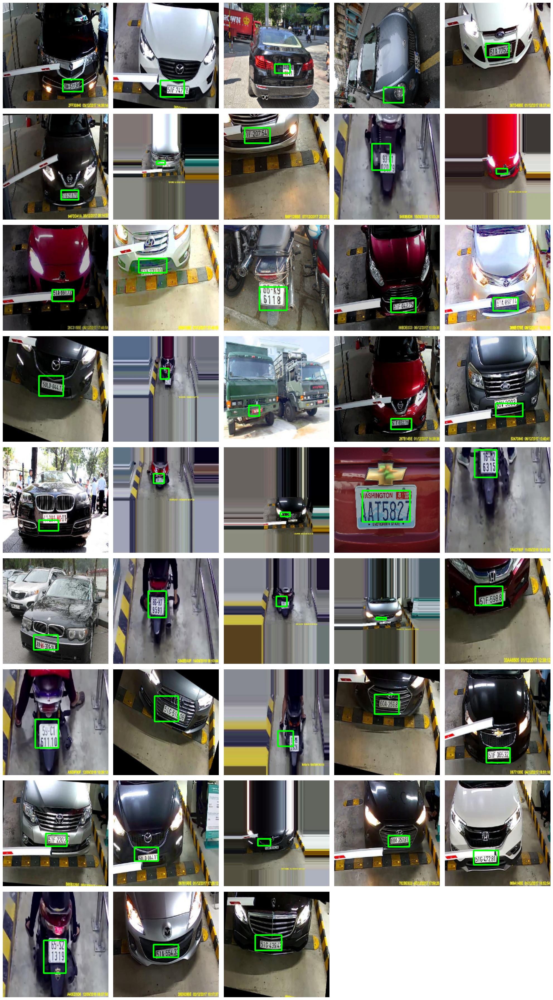

In [29]:
num_images = min(43, len(X_test))  # Ensuring predicitons on 43 images

plt.figure(figsize=(20, 40))

for i in range(num_images):
    plt.subplot(10, 5, i + 1)
    plt.axis('off')

    # Ensuring image is in the correct range
    ny = y_cnn1[i] * 1
    image = X_test[i].copy()  # Creating a copy of the image to avoid modifying the original
    
    # Draw bounding box on the image
    image = cv2.rectangle(image, (int(ny[0]), int(ny[1])), (int(ny[2]), int(ny[3])), (0, 255, 0), 2)

    plt.imshow(image)

plt.tight_layout()
plt.show()

## NasNet Model

In [30]:
from tensorflow.keras.applications import NASNetMobile                          # importing nasnet model
nas_model = train_model(NASNetMobile, config, y_train.shape[1], 'NASNetMobile')        # creating final nasnet model for training

Epoch 1/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 67s 170ms/step - accuracy: 0.3349 - loss: 72.0276 - val_accuracy: 0.5581 - val_loss: 24.4207
Epoch 2/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 10s 53ms/step - accuracy: 0.5291 - loss: 28.0558 - val_accuracy: 0.7014 - val_loss: 20.5977
Epoch 3/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 10s 52ms/step - accuracy: 0.5927 - loss: 24.0348 - val_accuracy: 0.7280 - val_loss: 18.8116
Epoch 4/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 10s 51ms/step - accuracy: 0.6303 - loss: 21.9298 - val_accuracy: 0.7292 - val_loss: 17.6553
Epoch 5/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 10s 51ms/step - accuracy: 0.6662 - loss: 20.9831 - val_accuracy: 0.7388 - val_loss: 16.9710
Epoch 6/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 10s 52ms/step - accuracy: 0.6904 - loss: 19.9782 - val_accuracy: 0.7456 - val_loss: 16.3899
Epoch 7/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 10s 51ms/step - accuracy: 0.6939 - loss: 19.4737 - val_accuracy: 0.7620 - val_loss: 16.1342
Epoch 8/10
193/193 ━━━━━━━━━━━━━━━━━━━━ 10s 51ms/step - accuracy: 0.7235 - 

In [31]:
test_loss_nas, test_accuracy_nas = nas_model.evaluate(X_test, y_test)           # evaluating Nasnet model
print("Test results \n Loss:",test_loss_nas,'\n Accuracy',test_accuracy_nas)

28/28 ━━━━━━━━━━━━━━━━━━━━ 11s 404ms/step - accuracy: 0.7868 - loss: 14.8961
Test results 
 Loss: 15.225909233093262 
 Accuracy 0.7913832068443298


In [32]:
y_cnn2 = nas_model.predict(X_test)           # making prediction on test images

28/28 ━━━━━━━━━━━━━━━━━━━━ 27s 510ms/step


In [33]:
# Computing mAP of Nasnet Model
map_score_nas = compute_map(y_cnn2, y_test)
print(f'mAP: {map_score_nas}')
test_map_nas = map_score_nas

mAP: 0.19071593245093005


##### Visualising predicitions of NasNet Model

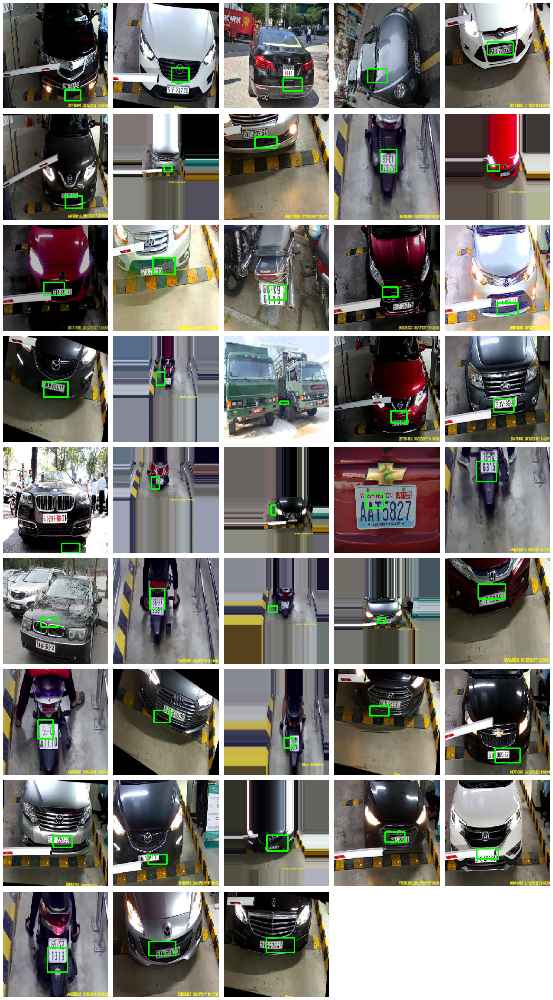

In [34]:
num_images = min(43, len(X_test))  # taking 43 test images for visualizing the predictions

plt.figure(figsize=(20, 40)) 
for i in range(num_images):
    plt.subplot(10, 5, i + 1)
    plt.axis('off')

    # Ensure image is in the correct range
    ny = y_cnn2[i] * 1
    image = X_test[i].copy()  # Creating a copy of the image to avoid modifying the original
    
    # Draw bounding box on the image
    image = cv2.rectangle(image, (int(ny[0]), int(ny[1])), (int(ny[2]), int(ny[3])), (0, 255, 0), 2)

    plt.imshow(image)

plt.tight_layout() 
plt.show()
